jupyter nbextension enable rise --py --sys-prefix

In [1]:
import warnings

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pandas_profiling
import plotly.offline as pyo
import plotly.graph_objs as go
import plotly_express as px
import seaborn as sns

In [2]:
%matplotlib inline
#sns.set_style('ticks')
pyo.init_notebook_mode(connected=True)
warnings.filterwarnings('ignore')

In [3]:
arrests = pd.read_csv('bpd_arrests.csv')
arrests['ArrestDate'] = (arrests['ArrestDate']
                         .apply(lambda x: pd.to_datetime(x)))
arrests.set_index('ArrestDate',inplace=True)
arrests['Day'] = arrests.index.day_name()
arrests['age_bins'] = pd.cut(arrests['Age'],7)
arrests['sex_race_count'] = (arrests.groupby(['Sex','Race'])
                             ['IncidentOffense']
                             .transform('count'))

In [4]:
arrests.age_bins.value_counts()

(24.429, 34.857]    17273
(13.927, 24.429]    12330
(34.857, 45.286]     8645
(45.286, 55.714]     5668
(55.714, 66.143]     1957
(66.143, 76.571]      170
(76.571, 87.0]         17
Name: age_bins, dtype: int64

In [5]:
bins_age = []
for age in arrests['Age']:
    if age <= 24:
        bins_age.append('13-24')
    elif (age >24) & (age <= 34):
        bins_age.append('24-34')
    elif (age >34) & (age <= 45):
        bins_age.append('34-45')
    elif (age >45) & (age <= 55):
        bins_age.append('45-55')
    elif (age >55) & (age <= 90):
        bins_age.append('55-90')
    elif np.isnan(age):
        bins_age.append('unknown')
    
arrests['ages'] = bins_age

In [6]:
arrests.head()

,Arrest,Age,Sex,Race,ArrestTime,ArrestLocation,IncidentOffense,IncidentLocation,Charge,ChargeDescription,District,Post,Neighborhood,Longitude,Latitude,Location 1,Day,age_bins,sex_race_count,ages
ArrestDate,,,,,,,,,,,,,,,,,,,,
2018-09-30,18148158.0,21.0,M,B,23:15,1800 BROADWAY WAY,Unknown Offense,1800 BROADWAY WAY,1 1119,CDS DIST,Eastern,343.0,Oliver,-76.595418,39.310749,"(39.310748790305, -76.595418068739)",Sunday,"(13.927, 24.429]",31575,13-24
2018-09-30,18148146.0,60.0,M,B,21:00,NaN,Unknown Offense,NaN,1 1415,ASSAULT-SEC DEGREE,NaN,NaN,NaN,NaN,NaN,NaN,Sunday,"(55.714, 66.143]",31575,55-90
2018-09-30,18148129.0,24.0,M,U,19:25,NaN,Unknown Offense,NaN,1 1415,ASSAULT-SEC DEGREE,NaN,NaN,NaN,NaN,NaN,NaN,Sunday,"(13.927, 24.429]",772,13-24
2018-09-30,18148130.0,25.0,M,B,19:00,30 GRANT ST,Unknown Offense,30 GRANT ST,1 0621,LARCENY,Central,111.0,Downtown,-76.612851,39.288068,"(39.288068191141, -76.612851350769)",Sunday,"(24.429, 34.857]",31575,24-34
2018-09-30,18148127.0,29.0,F,B,19:00,NaN,Unknown Offense,NaN,1 0077,FAILURE TO APPEAR,NaN,NaN,NaN,NaN,NaN,NaN,Sunday,"(24.429, 34.857]",6680,24-34


## matplotlib

In [264]:
age = arrests[(arrests['Age'].notnull())]['Age']

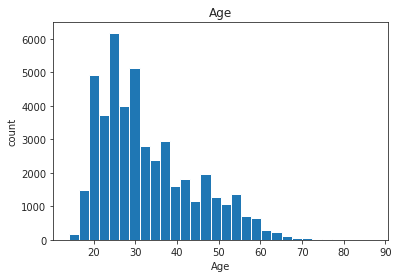

In [341]:
plt.title('Age')
plt.hist(age,bins=30)
plt.xlabel('Age')
plt.ylabel('count');

## seaborn

In [263]:
age = arrests[(arrests['Age'].notnull())]['Age']

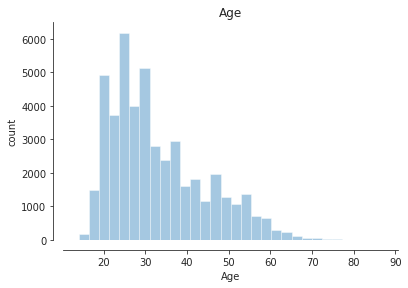

In [342]:
sns.distplot(age, kde=False, bins=30)
plt.title('Age')
plt.ylabel('count')

sns.despine(offset=10);

## plotly

In [346]:
age = arrests[(arrests['Age'].notnull())]['Age']

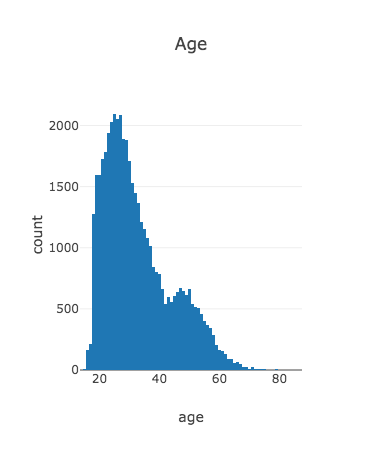

In [348]:
data = [go.Histogram(x=age)] # takes list
layout = {'title':'Age',
         'yaxis':{'title':'count'},
          'xaxis':{'title':'age'}}
fig = {'data':data,'layout':layout}

pyo.iplot(fig)

## plotly_express

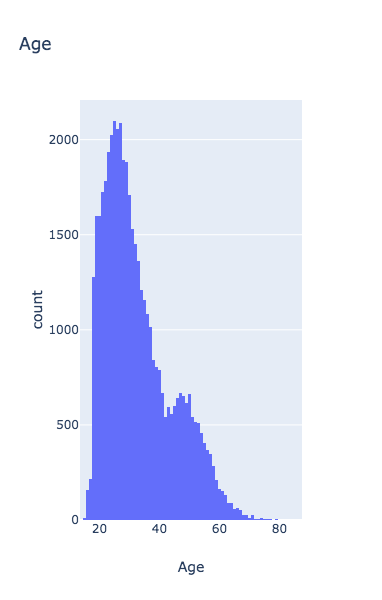

In [257]:
px.histogram(arrests,x='Age', title='Age')

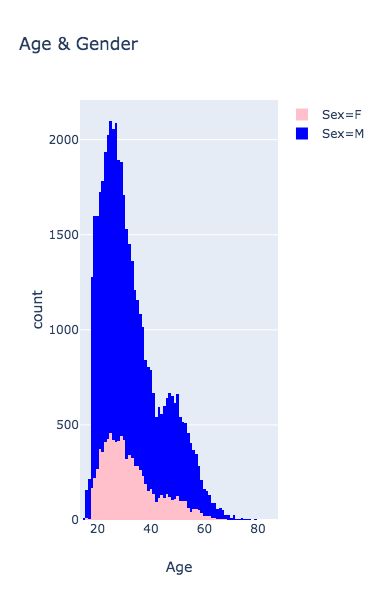

In [588]:
px.histogram(arrests, x='Age', color='Sex', 
             color_discrete_sequence=['pink','blue'],
            title='Age & Gender')

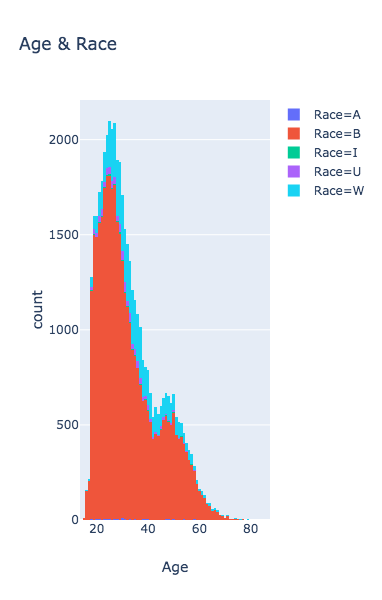

In [589]:
px.histogram(arrests, x='Age',color='Race', title='Age & Race')

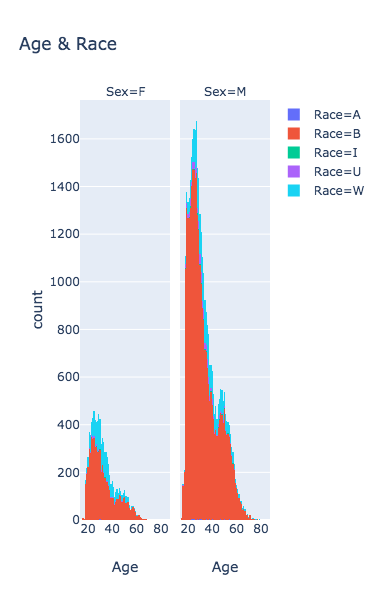

In [591]:
px.histogram(arrests, x='Age',color='Race',
             facet_col='Sex', title='Age & Race')

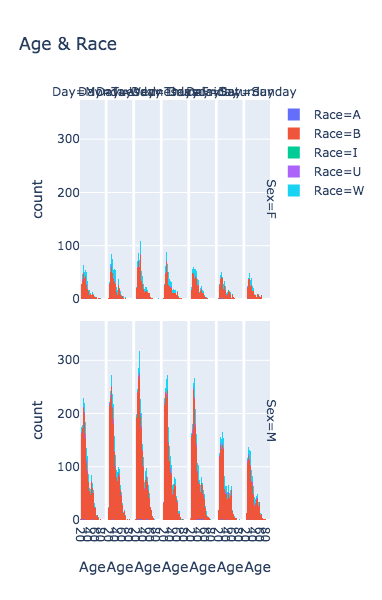

In [594]:
px.histogram(arrests, x='Age',color='Race',
             facet_col='Day', facet_row='Sex',
             title='Age & Race',
             category_orders={'Day':[
                'Monday','Tuesday','Wednesday','Thursday',
                'Friday','Saturday','Sunday']}
            )

## matplotlib

In [326]:
data = arrests.groupby('Race')['IncidentOffense'].count()

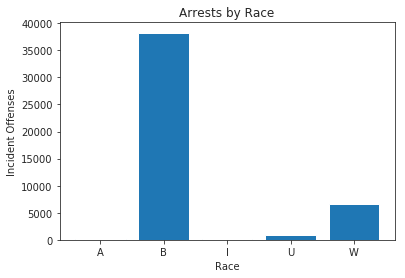

In [340]:
y_pos = np.arange(len(data))
plt.bar(x=y_pos, height=data.values)
plt.title('Arrests by Race')
plt.xticks(y_pos, data.index)
plt.xlabel('Race')
plt.ylabel('Incident Offenses');

## seaborn

In [332]:
data = arrests.groupby('Race')['IncidentOffense'].count()

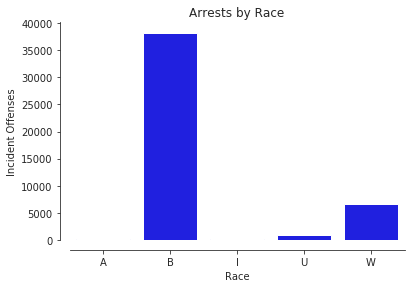

In [339]:
x = data.index
y = data.values
sns.barplot(x,y,color='Blue')
plt.title('Arrests by Race')
plt.ylabel('Incident Offenses')

sns.despine(offset=10);

## plotly

In [258]:
data = arrests.groupby('Race')['IncidentOffense'].count()

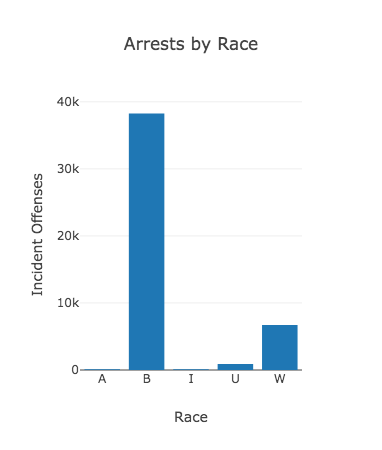

In [338]:
trace = [
    go.Bar(
        x = data.index,
        y = data.values,
    )
]

layout = {'title':'Arrests by Race',
         'hovermode':'closest',
         'xaxis':{'title':'Race'},
         'yaxis':{'title':'Incident Offenses'}}
fig = {'data':trace, 'layout':layout}
pyo.iplot(fig)

## plotly express

In [317]:
data = (pd.DataFrame(
    arrests[(arrests['Sex']==gender)]
    .groupby('Race')['IncidentOffense']
    .count()).reset_index())

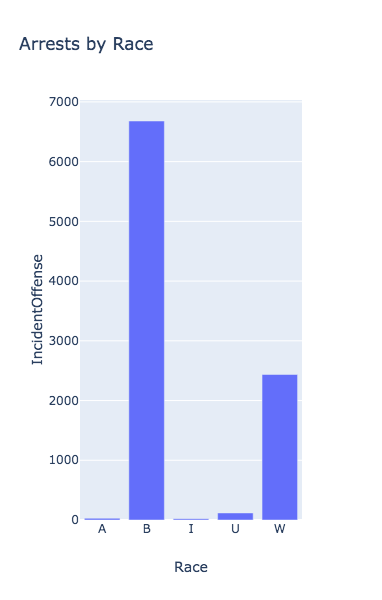

In [318]:
px.bar(data, x='Race',y='IncidentOffense', title='Arrests by Race')

## matplotlib

In [350]:
data = arrests['Day'].value_counts()

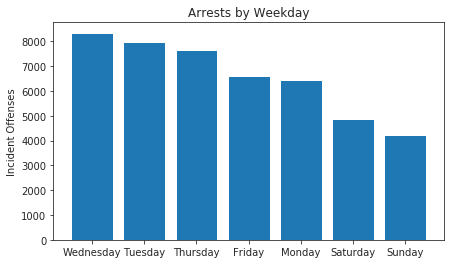

In [356]:
plt.figure(figsize=(7,4))
y_pos = np.arange(len(data))
plt.bar(y_pos, height=data)
plt.xticks(y_pos, data.index)
plt.ylabel('Incident Offenses')
plt.title('Arrests by Weekday');

## seaborn

In [270]:
data = arrests['Day'].value_counts()

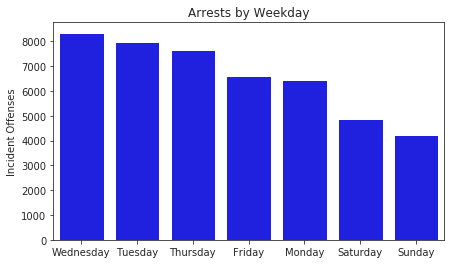

In [355]:
plt.figure(figsize=(7,4))
x = data.index 
y = data.values
sns.barplot(x,y,color='Blue')
plt.ylabel('Incident Offenses')
plt.title('Arrests by Weekday');

## plotly

In [285]:
data = arrests['Day'].value_counts()

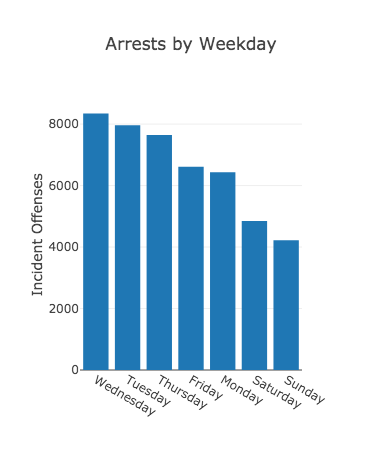

In [354]:
trace = [
    go.Bar(
        x = data.index,
        y = data.values,
    )
]

layout = {'title':'Arrests by Weekday',
         'hovermode':'closest',
         'yaxis':{'title':'Incident Offenses'}}
fig = {'data':trace, 'layout':layout}
pyo.iplot(fig)

## plotly express

In [606]:
data = (pd.DataFrame(arrests.groupby('Day')['IncidentOffense']
                     .count()).reset_index())
data = data.sort_values(by='IncidentOffense', ascending=False )

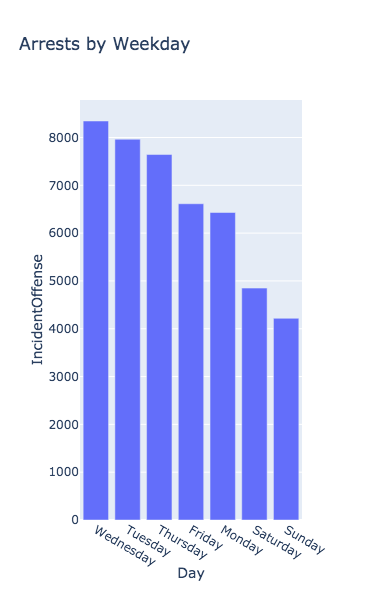

In [607]:
px.bar(data,x='Day', y='IncidentOffense', title='Arrests by Weekday')

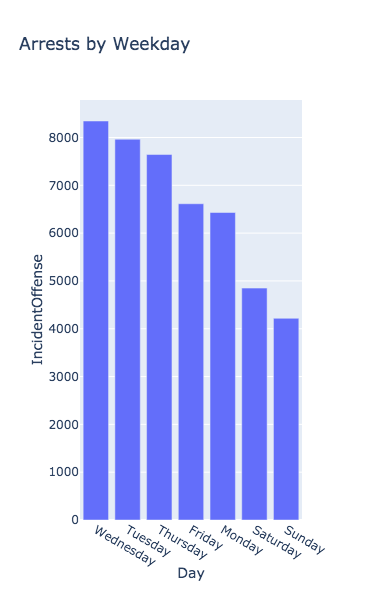

In [609]:
px.bar(data,x='Day', y='IncidentOffense',title='Arrests by Weekday')

In [595]:
arrests.head()

,Arrest,Age,Sex,Race,ArrestTime,ArrestLocation,IncidentOffense,IncidentLocation,Charge,ChargeDescription,District,Post,Neighborhood,Longitude,Latitude,Location 1,Day,age_bins,sex_race_count,ages
ArrestDate,,,,,,,,,,,,,,,,,,,,
2018-09-30,18148158.0,21.0,M,B,23:15,1800 BROADWAY WAY,Unknown Offense,1800 BROADWAY WAY,1 1119,CDS DIST,Eastern,343.0,Oliver,-76.595418,39.310749,"(39.310748790305, -76.595418068739)",Sunday,"(13.927, 24.429]",31575,13-24
2018-09-30,18148146.0,60.0,M,B,21:00,NaN,Unknown Offense,NaN,1 1415,ASSAULT-SEC DEGREE,NaN,NaN,NaN,NaN,NaN,NaN,Sunday,"(55.714, 66.143]",31575,55-90
2018-09-30,18148129.0,24.0,M,U,19:25,NaN,Unknown Offense,NaN,1 1415,ASSAULT-SEC DEGREE,NaN,NaN,NaN,NaN,NaN,NaN,Sunday,"(13.927, 24.429]",772,13-24
2018-09-30,18148130.0,25.0,M,B,19:00,30 GRANT ST,Unknown Offense,30 GRANT ST,1 0621,LARCENY,Central,111.0,Downtown,-76.612851,39.288068,"(39.288068191141, -76.612851350769)",Sunday,"(24.429, 34.857]",31575,24-34
2018-09-30,18148127.0,29.0,F,B,19:00,NaN,Unknown Offense,NaN,1 0077,FAILURE TO APPEAR,NaN,NaN,NaN,NaN,NaN,NaN,Sunday,"(24.429, 34.857]",6680,24-34


## matplotlib

In [401]:
data_male = (arrests[(arrests['Sex']=='M')]
             .groupby('Race')['IncidentOffense'].count())

data_female = (arrests[(arrests['Sex']=='F')]
             .groupby('Race')['IncidentOffense'].count())       

Race
A      29
B    6680
I      22
U     118
W    2436
Name: IncidentOffense, dtype: int64

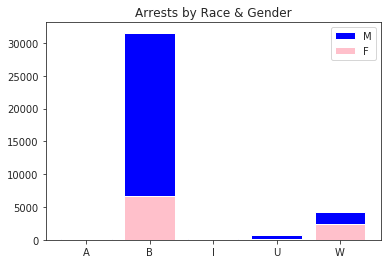

In [436]:
labels = data_male.index
men = data_male.values
women = data_female.values
y_pos = np.arange(len(men))
plt.bar(y_pos, men, color='Blue', label='M')
plt.bar(y_pos, women, color='Pink', label='F')
plt.xticks(y_pos, labels) 
plt.title('Arrests by Race & Gender')
plt.legend() ;

## seaborn

In [430]:
data_male = (arrests[(arrests['Sex']=='M')]
             .groupby('Race')['IncidentOffense'].count())

data_female = (arrests[(arrests['Sex']=='F')]
             .groupby('Race')['IncidentOffense'].count())

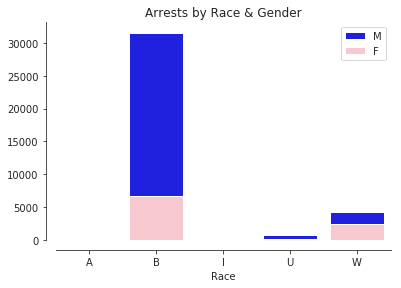

In [444]:
sns.barplot(x=data_male.index, y=data_male.values, 
            color='Blue', label='M')

sns.barplot(x=data_female.index, y=data_female.values,
            color='Pink', label='F')
plt.legend()
plt.title('Arrests by Race & Gender')

sns.despine(offset=10);

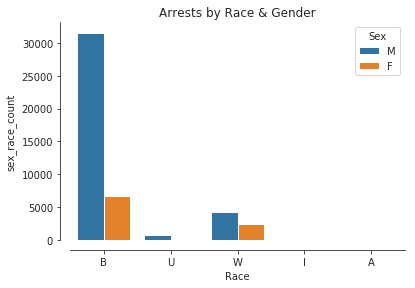

In [473]:
sns.barplot(x='Race', y='sex_race_count', hue='Sex', 
            data=arrests)
plt.title('Arrests by Race & Gender')

sns.despine(offset=10);

## plotly

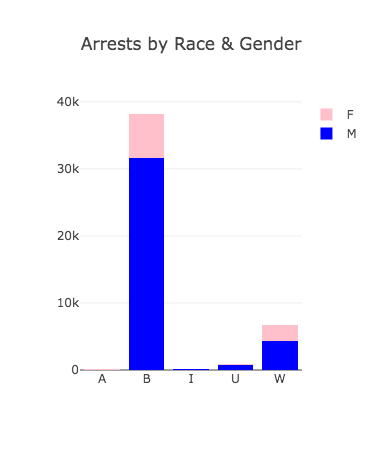

In [445]:
traces = []
for gender,colors in zip(arrests['Sex'].unique(),['blue','pink']):
    traces.append(
        go.Bar(
            x = (arrests[(arrests['Sex']==gender)]
                .groupby('Race')['IncidentOffense'].count()
                .index),
            y = (arrests[(arrests['Sex']==gender)]
                .groupby('Race')['IncidentOffense'].count()
                .values),
            name = gender,
            marker = {'color':colors}
        )
    )

layout = {'title':'Arrests by Race & Gender',
         'hovermode':'closest',
         'barmode':'stack'}
fig = {'data':traces, 'layout':layout}
pyo.iplot(fig)

## plotly express

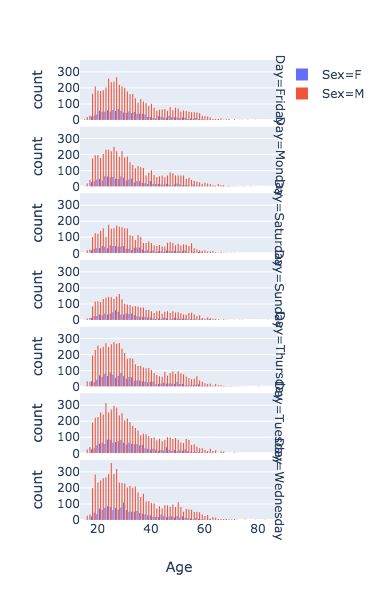

In [572]:
px.histogram(arrests, x='Age', color='Sex',
            facet_row='Day', orientation='v', barmode='group')

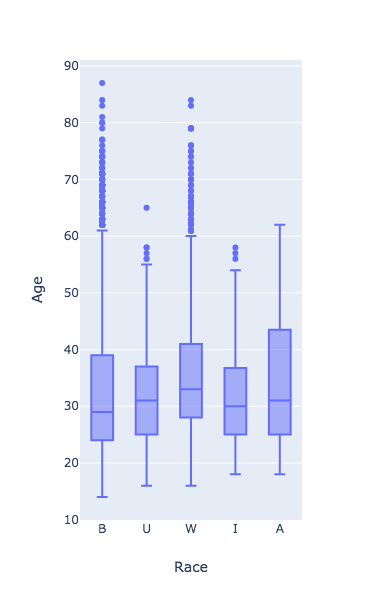

In [573]:
px.box(arrests, x='Race', y='Age')

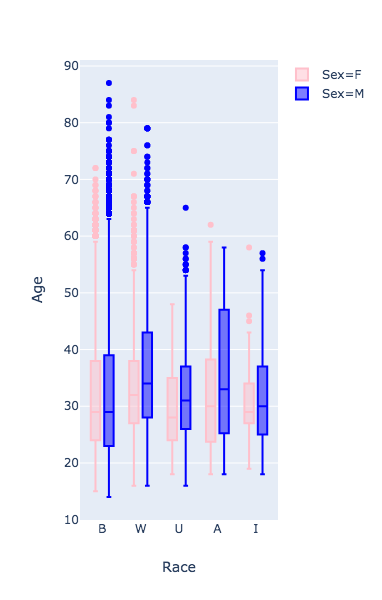

In [576]:
px.box(arrests, x='Race', y='Age', color='Sex',
      color_discrete_sequence=['pink','blue'])

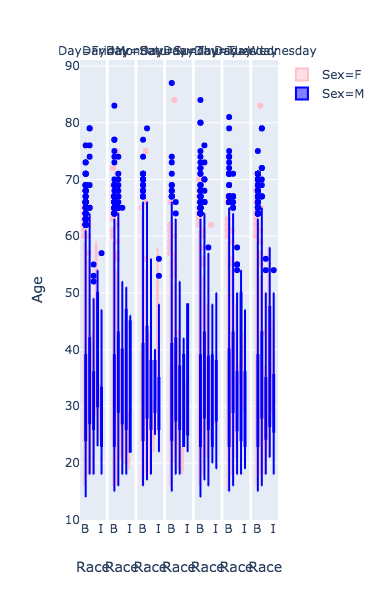

In [578]:
px.box(arrests, x='Race', y='Age', color='Sex',
      color_discrete_sequence=['pink','blue'], 
      facet_col='Day')

In [527]:
arrests.head()

,Arrest,Age,Sex,Race,ArrestTime,ArrestLocation,IncidentOffense,IncidentLocation,Charge,ChargeDescription,District,Post,Neighborhood,Longitude,Latitude,Location 1,Day,age_bins,sex_race_count,ages
ArrestDate,,,,,,,,,,,,,,,,,,,,
2018-09-30,18148158.0,21.0,M,B,23:15,1800 BROADWAY WAY,Unknown Offense,1800 BROADWAY WAY,1 1119,CDS DIST,Eastern,343.0,Oliver,-76.595418,39.310749,"(39.310748790305, -76.595418068739)",Sunday,"(13.927, 24.429]",31575,13-24
2018-09-30,18148146.0,60.0,M,B,21:00,NaN,Unknown Offense,NaN,1 1415,ASSAULT-SEC DEGREE,NaN,NaN,NaN,NaN,NaN,NaN,Sunday,"(55.714, 66.143]",31575,55-90
2018-09-30,18148129.0,24.0,M,U,19:25,NaN,Unknown Offense,NaN,1 1415,ASSAULT-SEC DEGREE,NaN,NaN,NaN,NaN,NaN,NaN,Sunday,"(13.927, 24.429]",772,13-24
2018-09-30,18148130.0,25.0,M,B,19:00,30 GRANT ST,Unknown Offense,30 GRANT ST,1 0621,LARCENY,Central,111.0,Downtown,-76.612851,39.288068,"(39.288068191141, -76.612851350769)",Sunday,"(24.429, 34.857]",31575,24-34
2018-09-30,18148127.0,29.0,F,B,19:00,NaN,Unknown Offense,NaN,1 0077,FAILURE TO APPEAR,NaN,NaN,NaN,NaN,NaN,NaN,Sunday,"(24.429, 34.857]",6680,24-34


['13-24',
 '55-90',
 '13-24',
 '24-34',
 '24-34',
 '34-45',
 '24-34',
 '34-45',
 '24-34',
 '24-34',
 '24-34',
 '55-90',
 '24-34',
 '24-34',
 '34-45',
 '55-90',
 '24-34',
 '34-45',
 '34-45',
 '34-45',
 '24-34',
 '34-45',
 '24-34',
 '24-34',
 '45-55',
 '45-55',
 '45-55',
 '24-34',
 '13-24',
 '13-24',
 '13-24',
 '13-24',
 '24-34',
 '13-24',
 '13-24',
 '34-45',
 '13-24',
 '24-34',
 '24-34',
 '13-24',
 '24-34',
 '24-34',
 '45-55',
 '13-24',
 '55-90',
 '13-24',
 '45-55',
 '55-90',
 '45-55',
 '13-24',
 '34-45',
 '24-34',
 '24-34',
 '24-34',
 '24-34',
 '45-55',
 '24-34',
 '34-45',
 '34-45',
 '45-55',
 '55-90',
 '34-45',
 '34-45',
 '24-34',
 '24-34',
 '24-34',
 '24-34',
 '34-45',
 '45-55',
 '24-34',
 '13-24',
 '13-24',
 '24-34',
 '34-45',
 '13-24',
 '34-45',
 '24-34',
 '34-45',
 '24-34',
 '24-34',
 '24-34',
 '45-55',
 '34-45',
 '13-24',
 '24-34',
 '45-55',
 '34-45',
 '34-45',
 '34-45',
 '13-24',
 '34-45',
 '45-55',
 '24-34',
 '24-34',
 '24-34',
 '34-45',
 '13-24',
 '24-34',
 '34-45',
 '13-24',


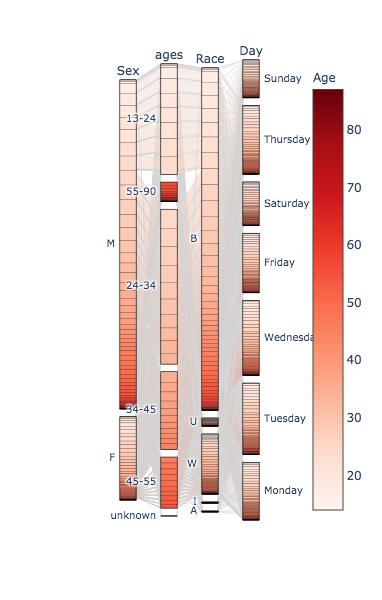

In [579]:
df_filter = arrests[['Age','Sex','ages','Race','Day']]
px.parallel_categories(df_filter, color='Age',
                      color_continuous_scale=px.colors
                       .sequential.Reds)

## matplotlib

In [360]:
data = arrests.groupby(arrests.index)['Day'].count()

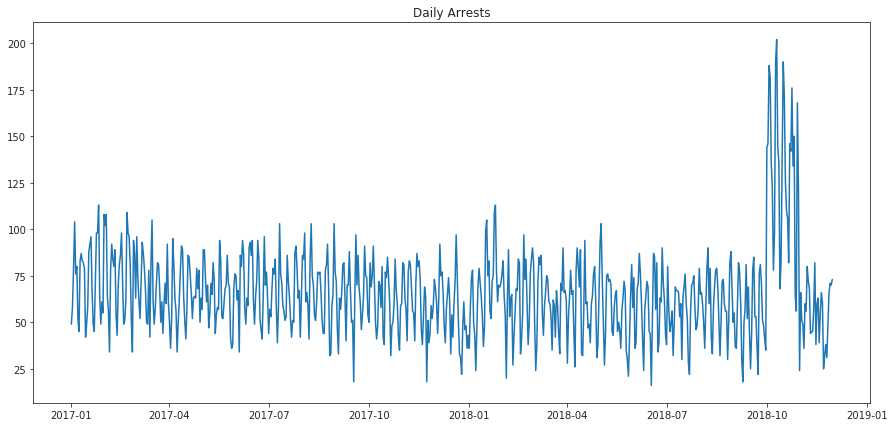

In [361]:
plt.figure(figsize=(15,7))
plt.plot(data)
plt.title('Daily Arrests');

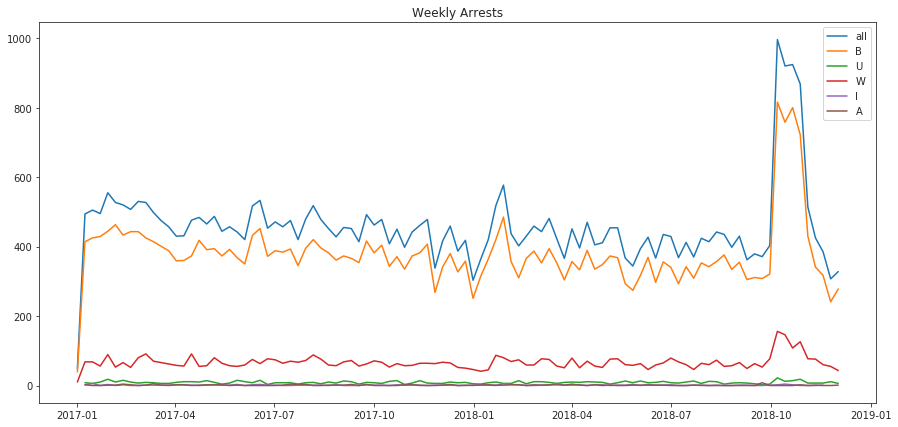

In [359]:
data = arrests.resample('W')['Day'].count()
plt.figure(figsize=(15,7))
plt.plot(data, label='all')

race_arrest_data = {}
for race in arrests['Race'].unique():
    race_arrest_data[race] = (
        arrests[(arrests['Race']==race)].resample('W')['Race'].count())
    
    # add trace for each race category
    plt.plot(race_arrest_data[race],label=race)

plt.legend()
plt.title('Weekly Arrests');

In [380]:
daily_arrests = arrests.groupby(arrests.index)['Day'].count()
arrests['daily_arrests'] = daily_arrests

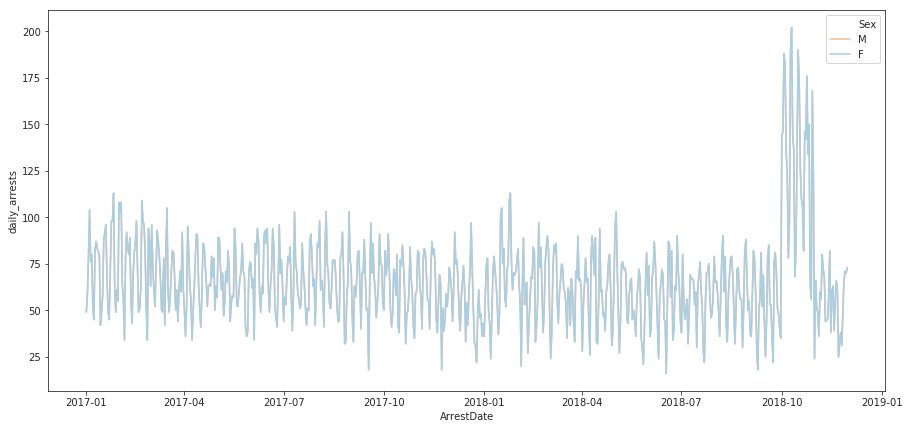

In [390]:
plt.figure(figsize=(15,7))
sns.lineplot(x=arrests.index, y=arrests['daily_arrests'],
            hue='Sex', data=arrests, palette='RdBu' )

## matplotlib

## seaaborn

In [363]:
data = arrests.groupby(arrests.index)['Day'].count()
data

ArrestDate
2017-01-01     49
2017-01-02     58
2017-01-03     79
2017-01-04    104
2017-01-05     76
2017-01-06     80
2017-01-07     52
2017-01-08     45
2017-01-09     83
2017-01-10     87
2017-01-11     83
2017-01-12     82
2017-01-13     79
2017-01-14     42
2017-01-15     49
2017-01-16     58
2017-01-17     88
2017-01-18     92
2017-01-19     96
2017-01-20     67
2017-01-21     49
2017-01-22     45
2017-01-23     72
2017-01-24     98
2017-01-25     98
2017-01-26    113
2017-01-27     64
2017-01-28     49
2017-01-29     61
2017-01-30     55
             ... 
2018-11-01     66
2018-11-02     51
2018-11-03     49
2018-11-04     36
2018-11-05     60
2018-11-06     56
2018-11-07     80
2018-11-08     72
2018-11-09     68
2018-11-10     44
2018-11-11     45
2018-11-12     45
2018-11-13     58
2018-11-14     82
2018-11-15     38
2018-11-16     60
2018-11-17     63
2018-11-18     39
2018-11-19     55
2018-11-20     66
2018-11-21     60
2018-11-22     25
2018-11-23     32
2018-11-24     38

## plotly 

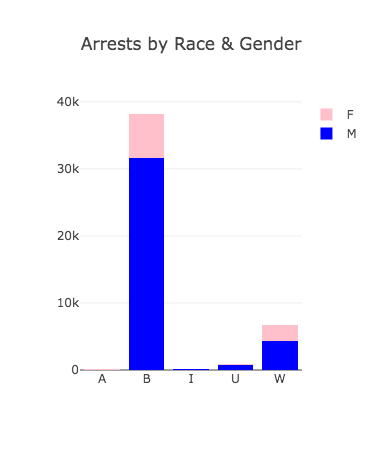

In [249]:
traces = []
for gender,colors in zip(arrests['Sex'].unique(),['blue','pink']):
    traces.append(
        go.Bar(
            x = (arrests[(arrests['Sex']==gender)]
                .groupby('Race')['IncidentOffense'].count()
                .index),
            y = (arrests[(arrests['Sex']==gender)]
                .groupby('Race')['IncidentOffense'].count()
                .values),
            name = gender,
            marker = {'color':colors}
        )
    )

layout = {'title':'Arrests by Race & Gender',
         'hovermode':'closest',
         'barmode':'stack'}
fig = {'data':traces, 'layout':layout}
pyo.iplot(fig)

## plotly express